In [1]:
import torch
import numpy as np
import cv2
# Fixar a semente do Torch para operações específicas
torch.manual_seed(0)
torch.cuda.manual_seed(0)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

In [2]:
#First load libraries and images
import math
import torchvision
from torch import optim
from torch.optim.lr_scheduler import ExponentialLR
from torchvision.transforms import transforms, InterpolationMode
import best.singular_point as sp

transform = transforms.Compose([
    transforms.Resize((sp.args.img_size, sp.args.img_size), interpolation=InterpolationMode.BICUBIC),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

transform2 = transforms.Compose([
    transforms.Resize((sp.args.img_size, sp.args.img_size), interpolation=InterpolationMode.BICUBIC),
    transforms.Grayscale(),
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5))
])

trainset = torchvision.datasets.Flowers102(root='./data/datasets', split='train',
                                        download=True, transform=transform2)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=5,
                                        shuffle=False, num_workers=2)

testset = torchvision.datasets.Flowers102(root='./data/datasets', split='test',
                                        download=True, transform=transform2)

num_datapoints_to_keep = math.ceil(len(testset) / 2)
num_datapoints_to_keep = 1020
indices_to_keep = torch.randperm(num_datapoints_to_keep)[:num_datapoints_to_keep]
reduced_testset = torch.utils.data.Subset(testset, indices_to_keep)
testloader = torch.utils.data.DataLoader(reduced_testset, batch_size=5,
                                        shuffle=False, num_workers=2)


In [3]:
import kornia

class AugmentationParamsGenerator:
    def __init__(self, n, shape):
        torch.manual_seed(0)
        torch.cuda.manual_seed(0)

        aug_list = kornia.augmentation.AugmentationSequential(
            kornia.augmentation.RandomAffine(degrees=360, translate=(0.2, 0.2), scale=(0.95, 1.05), shear=10,p=0.8),
            kornia.augmentation.RandomPerspective(0.1, p=0.7),
            kornia.augmentation.RandomBoxBlur((5,5),p=0.7),
            data_keys=["input"],
            same_on_batch=True,
            # random_apply=10,
        )

        self.index = 0
        self.data = []
        for i in range(n):
            out = aug_list(torch.rand(shape))
            self.data.append(aug_list._params)

    def __iter__(self):
        return self

    def __next__(self):
        if self.index >= len(self.data):
            self.index = 0  # Reset index to start over for circular iteration

        result = self.data[self.index]
        self.index += 1
        return result


iterator=iter(testloader)
img,labels = next(iterator)
print(img.shape,labels.shape)
# img = img.to(sp.device)

params_lists =AugmentationParamsGenerator(6,img.shape)

torch.Size([5, 1, 120, 120]) torch.Size([5])


In [4]:
from kornia.feature import *
# device = torch.device('cpu')
device = torch.device('cuda:0')
PS = 19 # patch size
sift = kornia.feature.SIFTDescriptor(PS, rootsift=True).to(device)
descriptor = sift
resp = BlobHessian()
scale_pyr = kornia.geometry.ScalePyramid(1, 1.3, PS, double_image=True)
print('scale_pyr ',scale_pyr)
nms = kornia.geometry.ConvQuadInterp3d(15)
n_features = 10

detector = ScaleSpaceDetector(n_features,
                              resp_module=resp,
                              nms_module=nms,
                              scale_pyr_module=scale_pyr,
                              ori_module=kornia.feature.LAFOrienter(PS),
                              minima_are_also_good=True,
                              mr_size=6.0).to(device)

scale_pyr  ScalePyramid(n_levels=1, init_sigma=1.3, min_size=19, extra_levels=3, border=8, sigma_step=2.0, double_image=True)


In [5]:
import matplotlib.pyplot as plt

def plot_images_with_points_side_by_side(image1, image2, points1=None, points2=None):
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))  # Cria uma figura com duas subplots

    # Converte tensores para imagens
    image1 = kornia.utils.tensor_to_image(image1)
    image2 = kornia.utils.tensor_to_image(image2)

    # Plot da primeira imagem na subplot da esquerda
    axs[0].imshow(image1)
    if points1 is not None:
        points1 = points1.cpu().numpy()  # Converte para numpy
        keypoints_x = points1[:,1].flatten().tolist()
        keypoints_y = points1[:,0].flatten().tolist()
        axs[0].scatter(keypoints_x, keypoints_y, c='red', marker='x')  # Plota os pontos em vermelho com marcador 'x'
    axs[0].axis('off')  # Remove os eixos

    # Plot da segunda imagem na subplot da direita
    axs[1].imshow(image2)
    if points2 is not None:
        points2 = points2.cpu().numpy()  # Converte para numpy
        keypoints_x = points2[:,1].flatten().tolist()
        keypoints_y = points2[:,0].flatten().tolist()
        axs[1].scatter(keypoints_x, keypoints_y, c='red', marker='x')
    axs[1].axis('off')  # Remove os eixos

    plt.show()  # Mostra o plot com as duas imagens lado a lado


In [6]:
aug_list = kornia.augmentation.AugmentationSequential(
            kornia.augmentation.RandomAffine(degrees=360, translate=(0.2, 0.2), scale=(0.95, 1.05), shear=10,p=0.8),
            kornia.augmentation.RandomPerspective(0.1, p=0.7),
            kornia.augmentation.RandomBoxBlur((5,5),p=0.7),
    # kornia.augmentation.RandomEqualize(p=0.3),
    data_keys=["input", "keypoints"],#data_keys=["input", "mask", "bbox", "keypoints"],
    same_on_batch=True,
    # random_apply=15,
)


def detect_extract_patches(batch,params_item, detector, PS):
    with torch.no_grad():
        lafs1, resps = detector(batch)
        src_pts = lafs1[:, :, :, 2]
        print('src_pts ',src_pts.shape,lafs1.shape)
        timg_gray_t,key_point_trans = aug_list(batch,src_pts,params=params_item)
        
        plot_images_with_points_side_by_side(batch[0],timg_gray_t[0],src_pts,key_point_trans)
        
        lafs2, resps = detector(timg_gray_t)
        dst_pts = lafs2[:, :, :, 2].data.cpu().numpy()
        
        # pc1 = kornia.feature.extract_patches_from_pyramid(image1[None], lafs1, PS)
        # B, N, CH, H, W = pc1.size()
        
    return None

  0%|          | 0/204 [00:00<?, ?it/s]

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


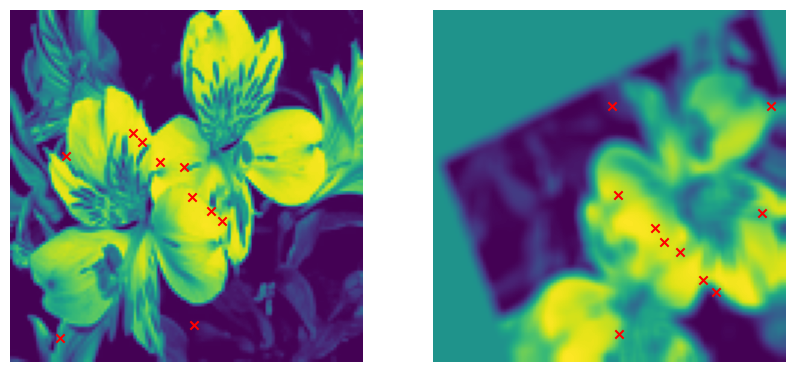

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


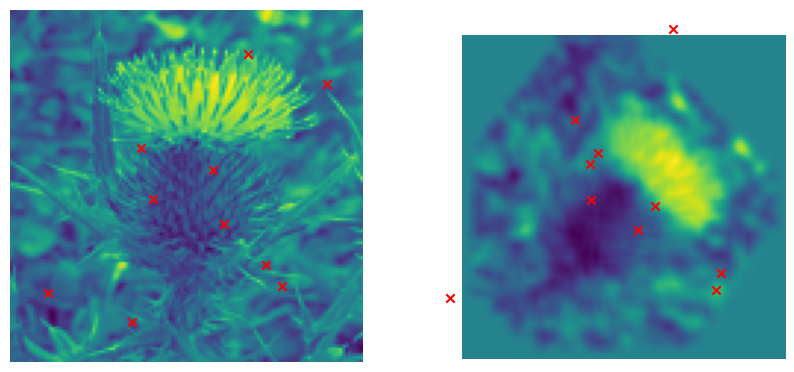

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


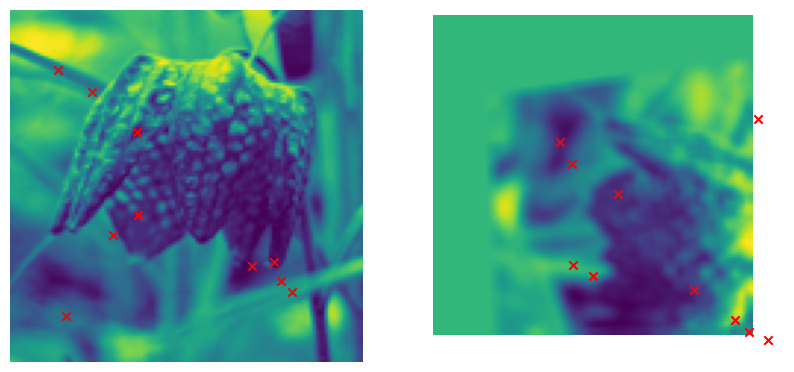

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


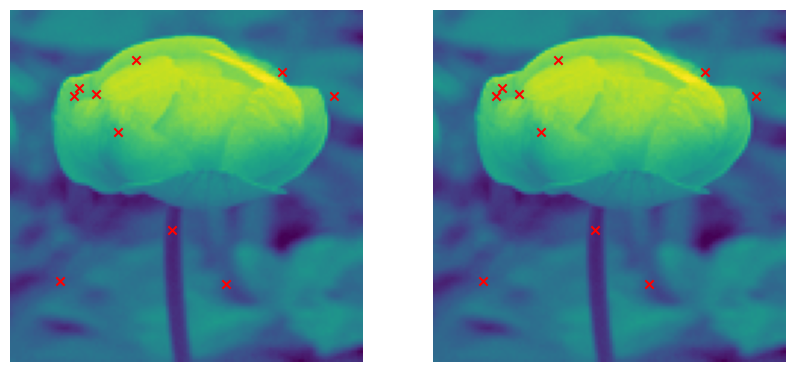

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


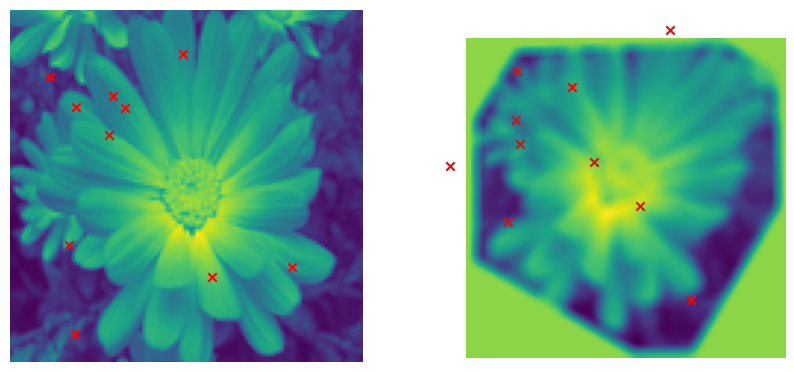

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


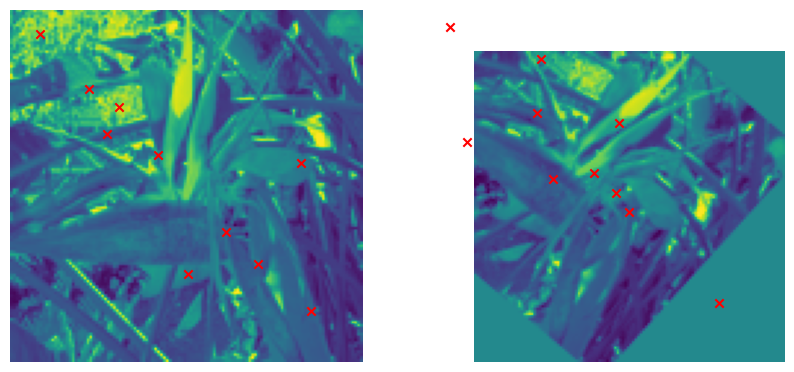

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


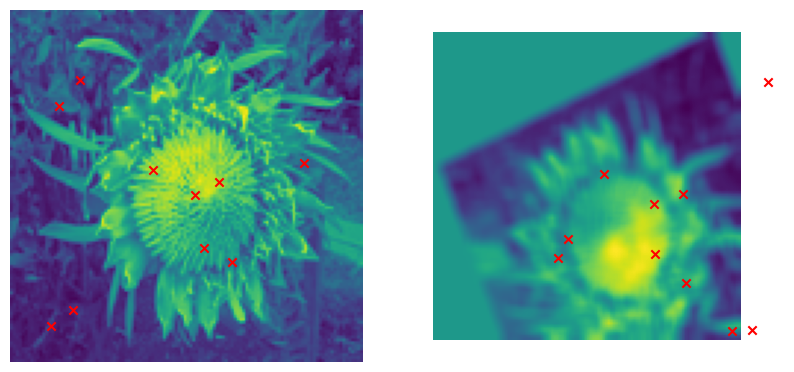

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


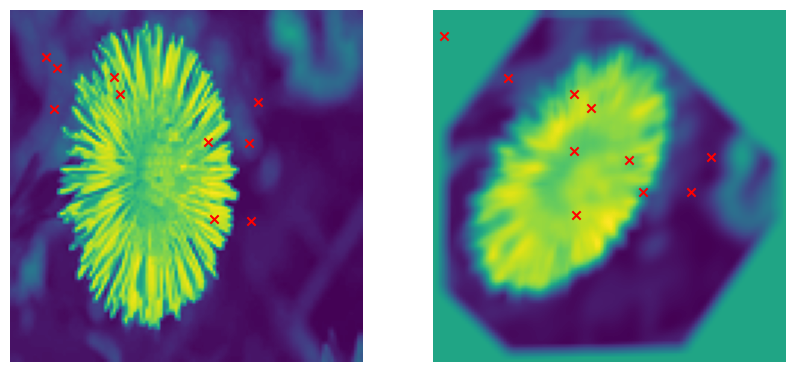

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


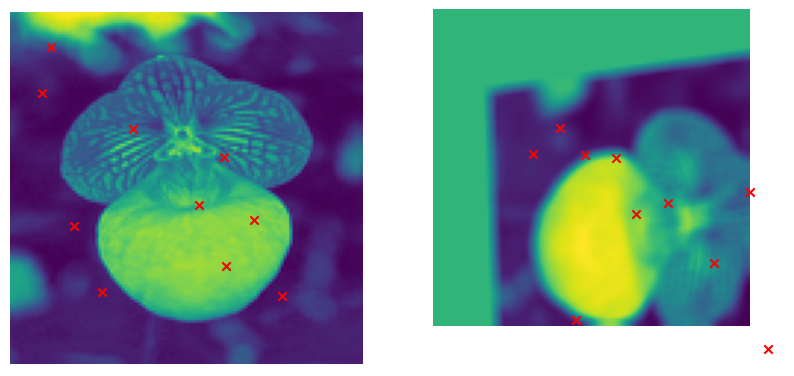

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


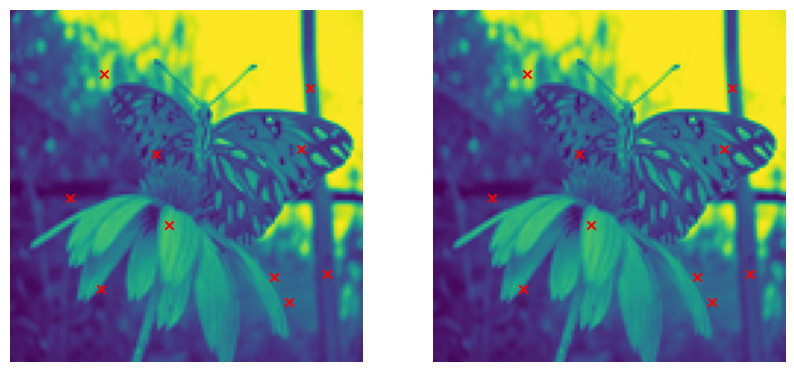

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


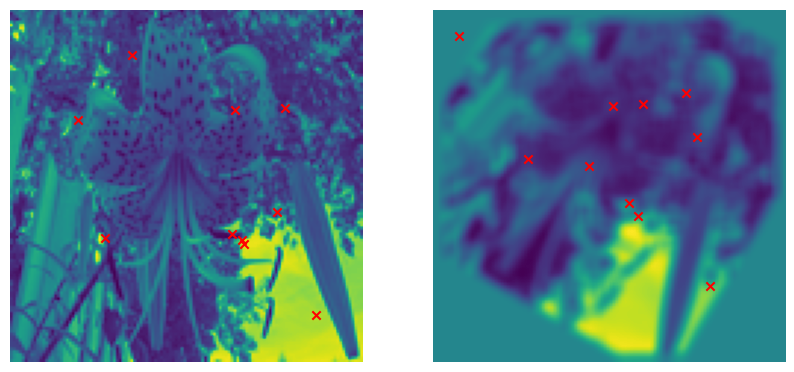

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


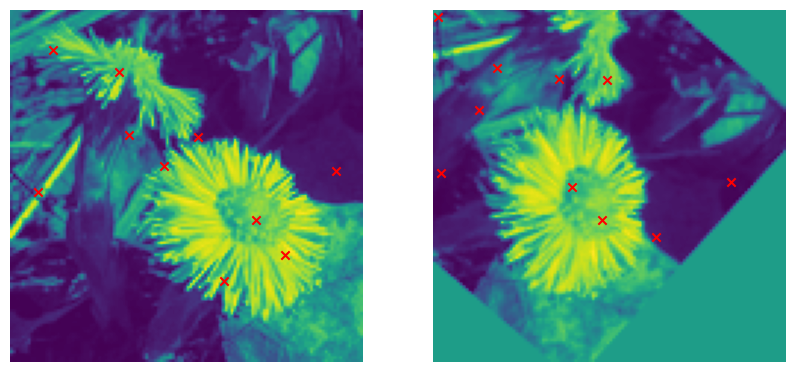

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


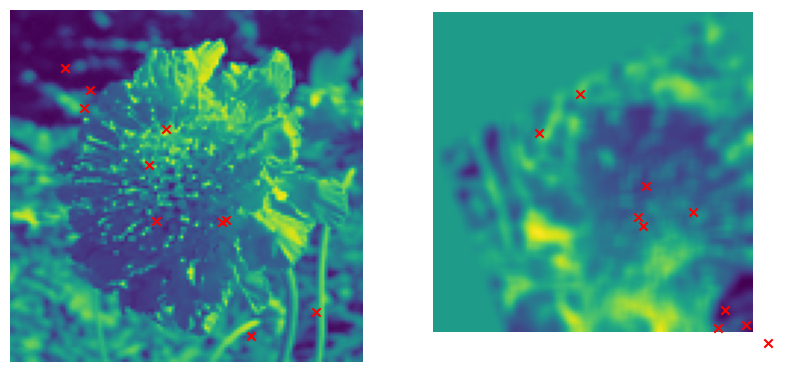

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


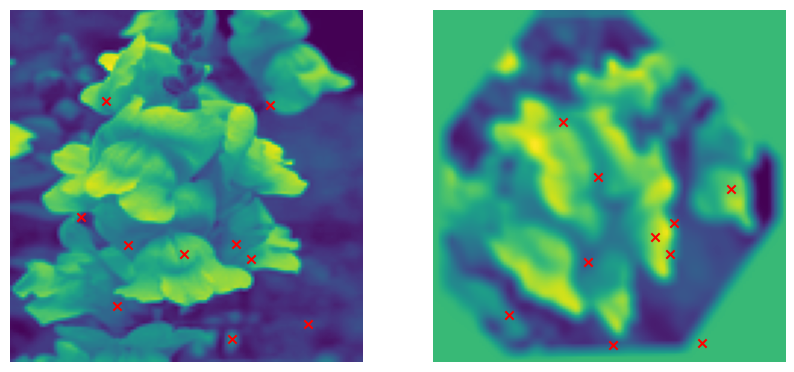

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


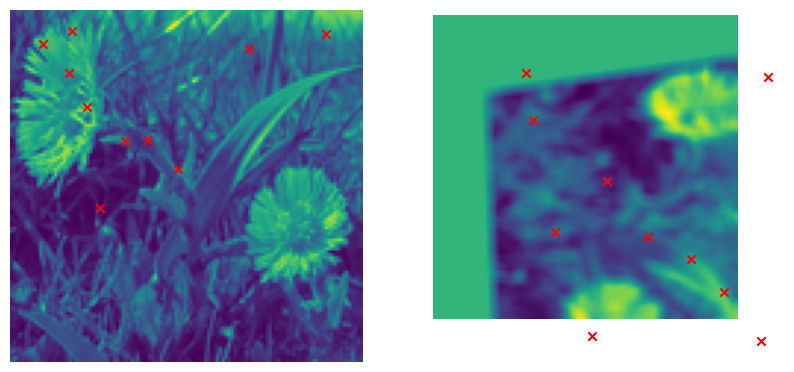

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


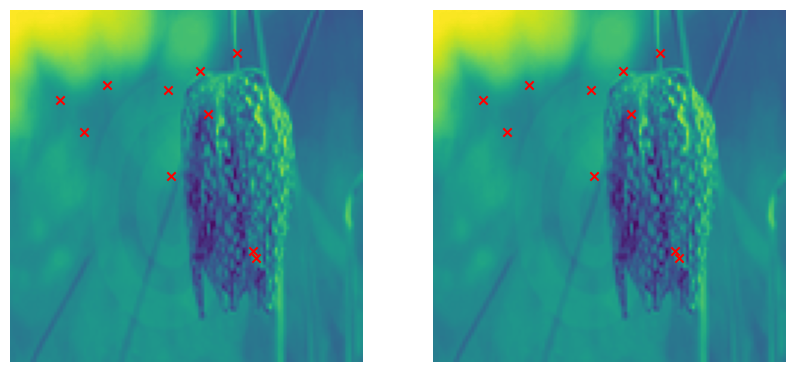

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


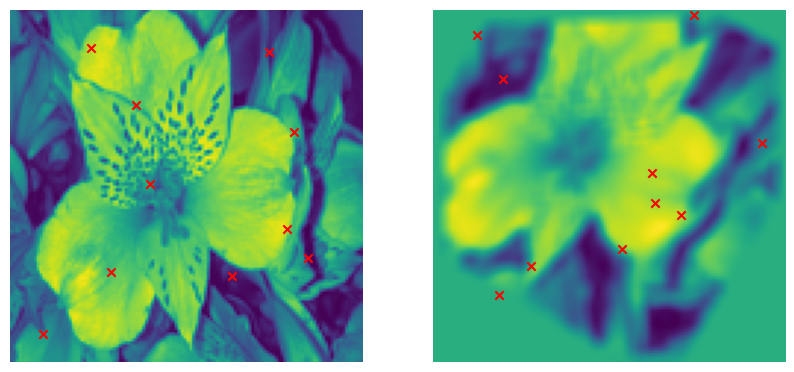

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


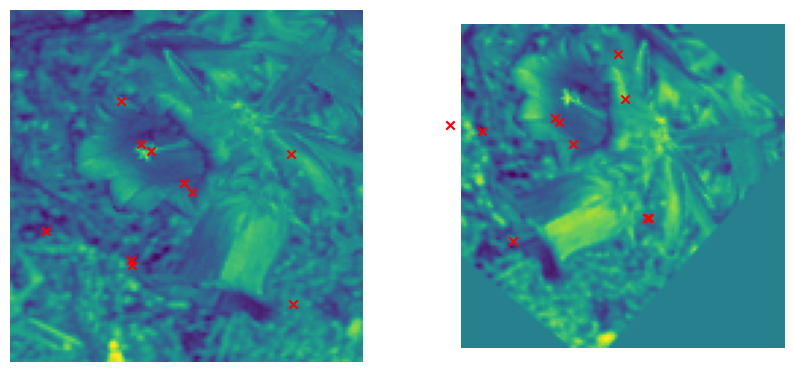

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


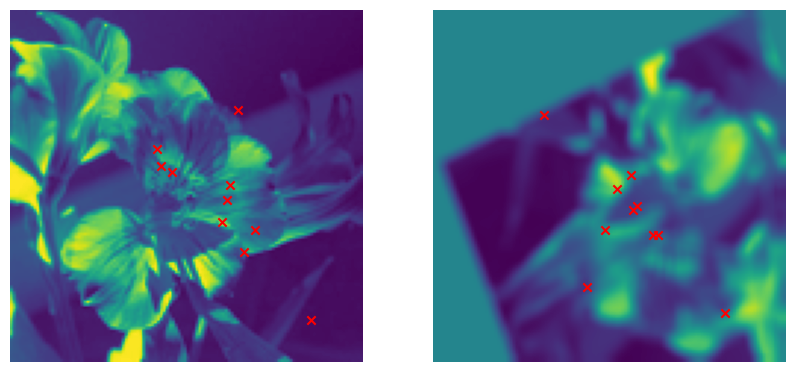

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


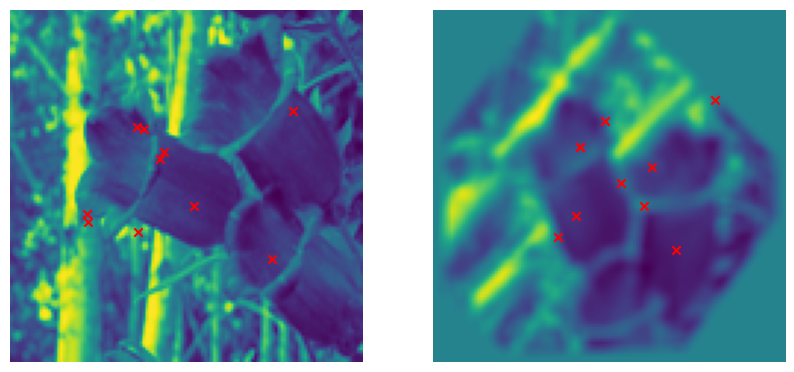

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


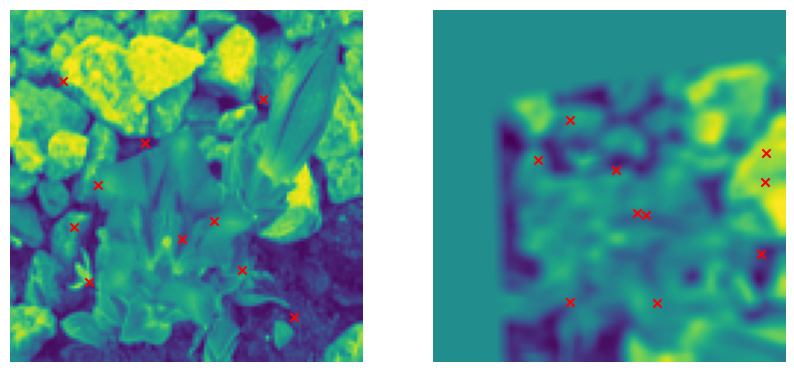

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


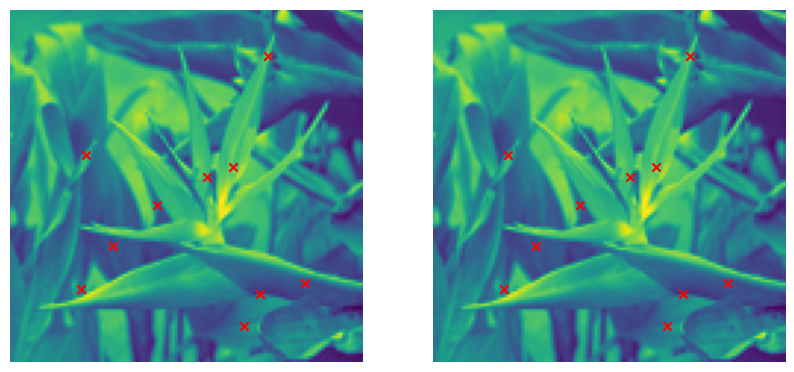

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


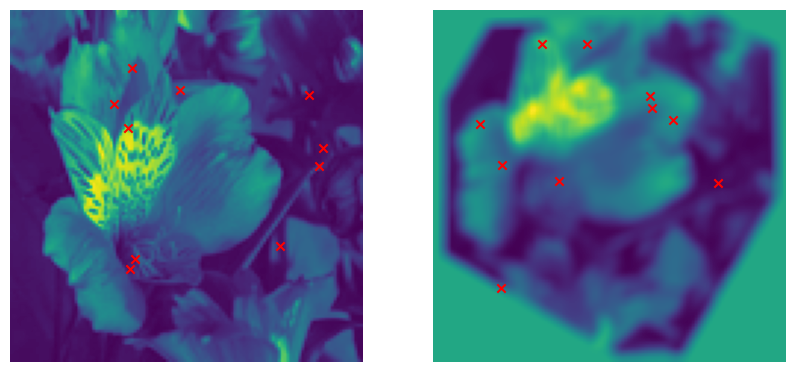

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


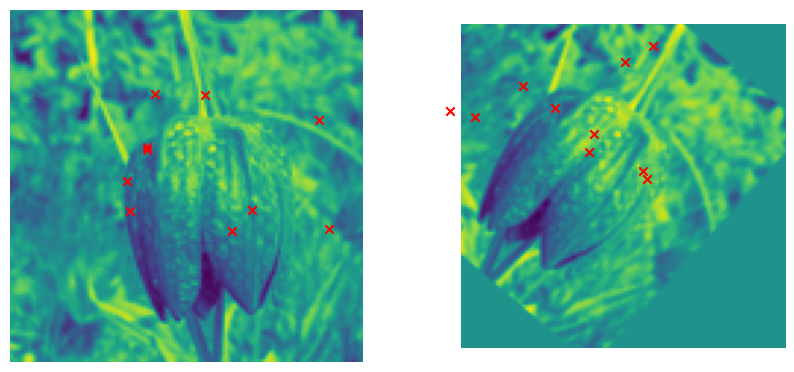

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


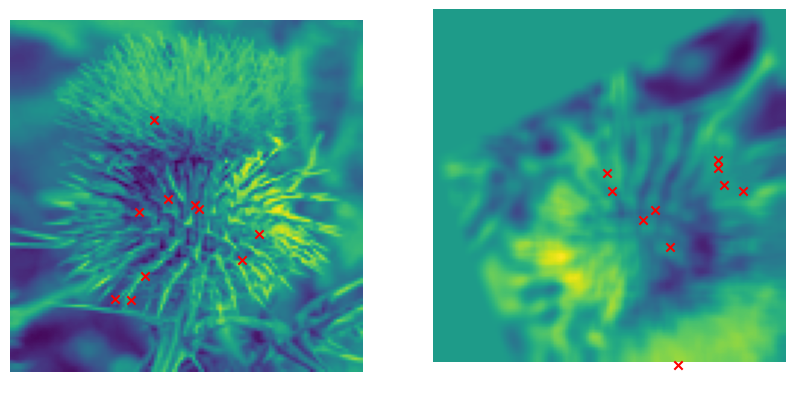

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


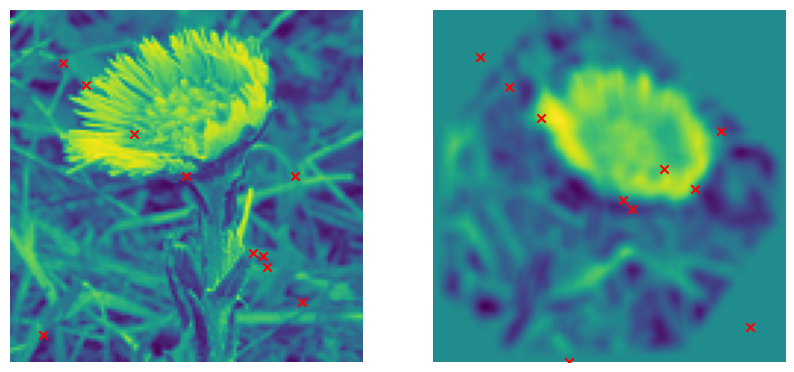

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


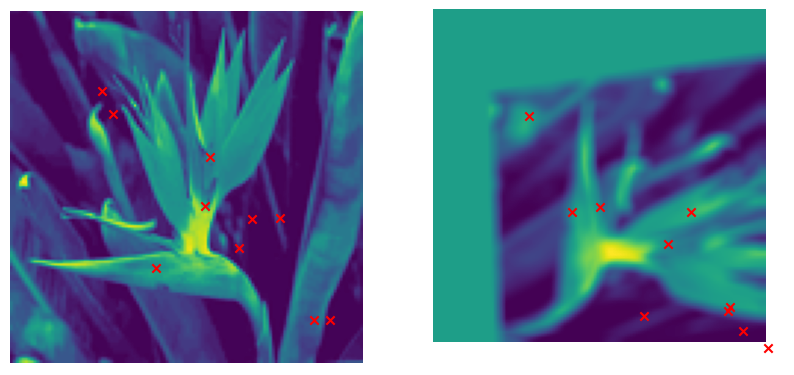

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


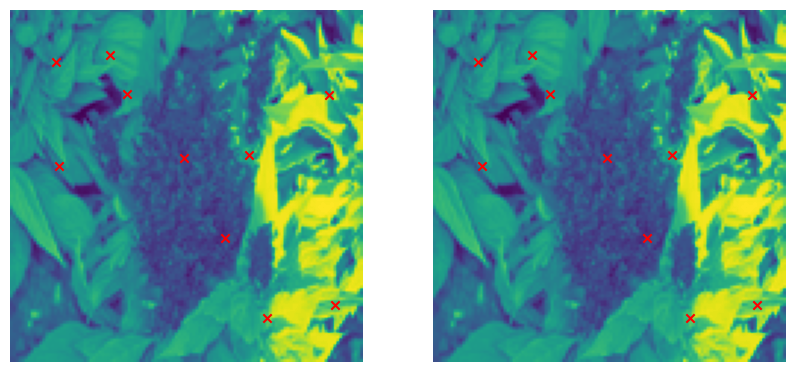

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


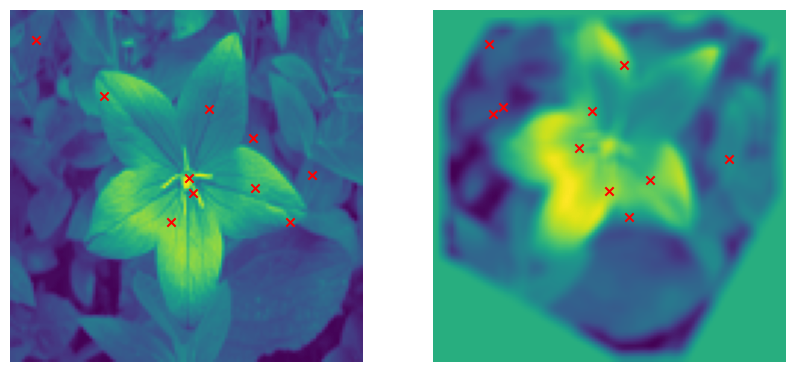

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


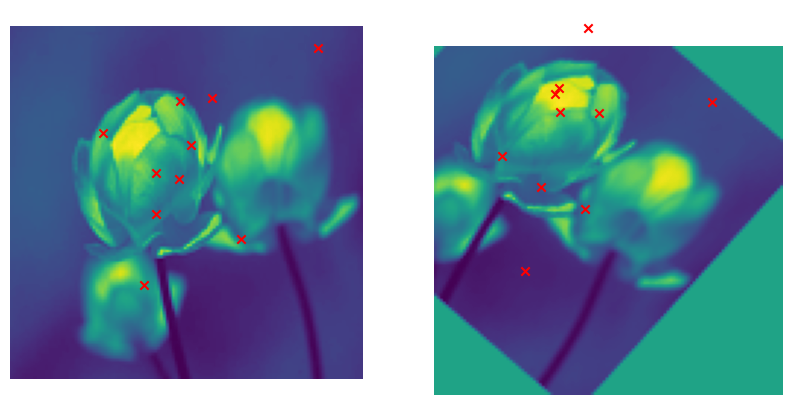

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


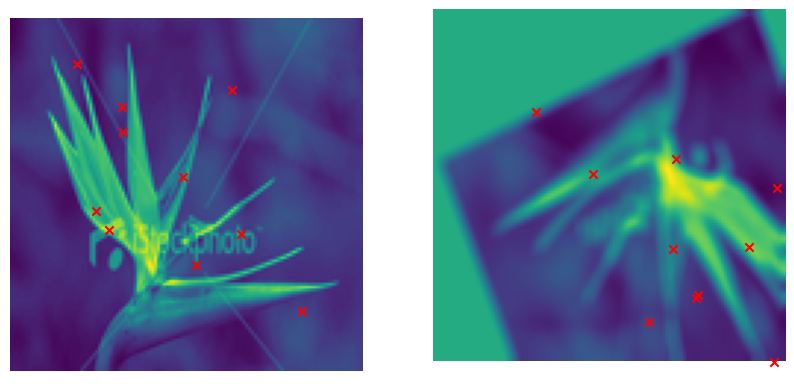

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


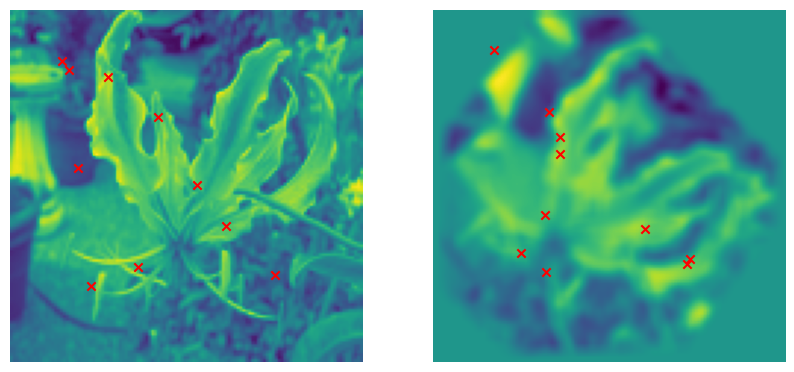

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


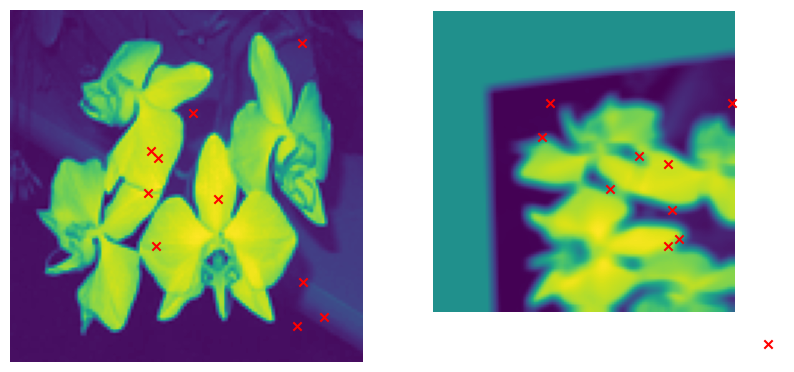

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


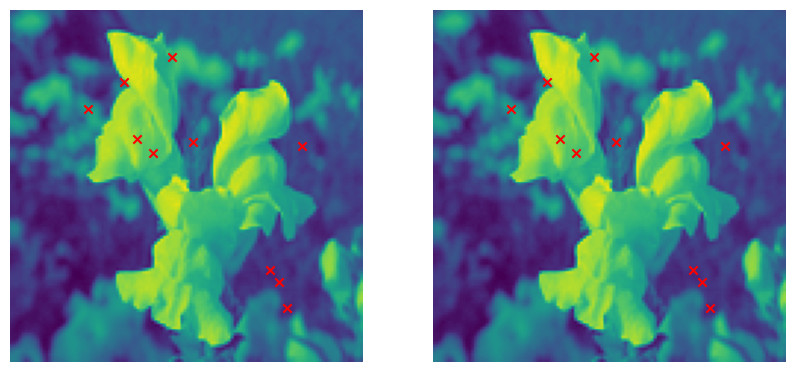

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


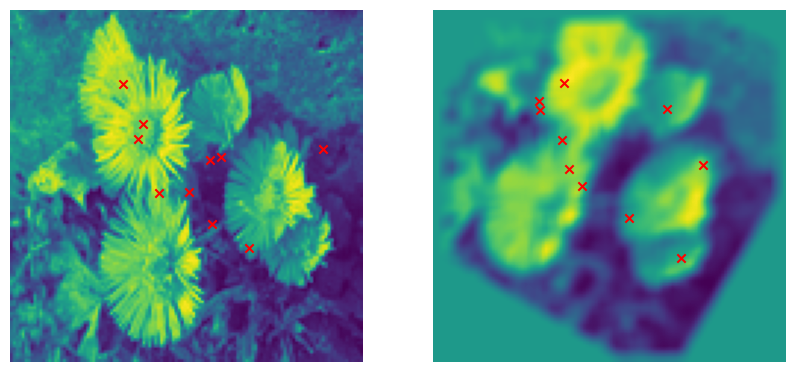

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


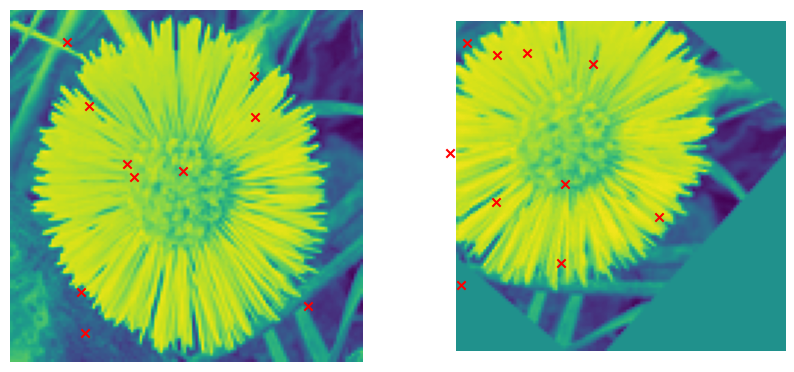

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


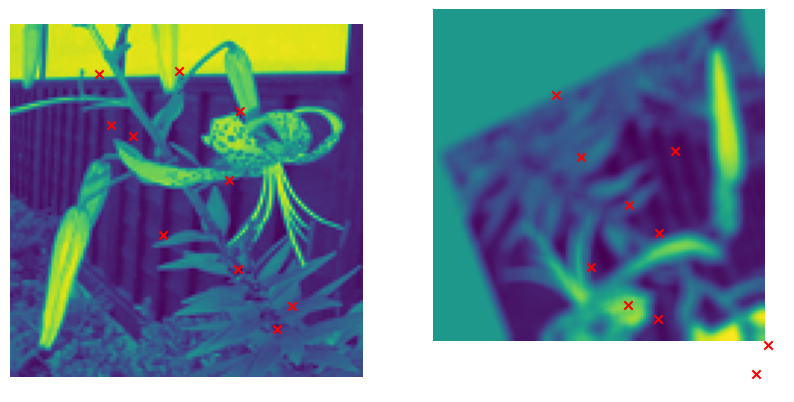

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


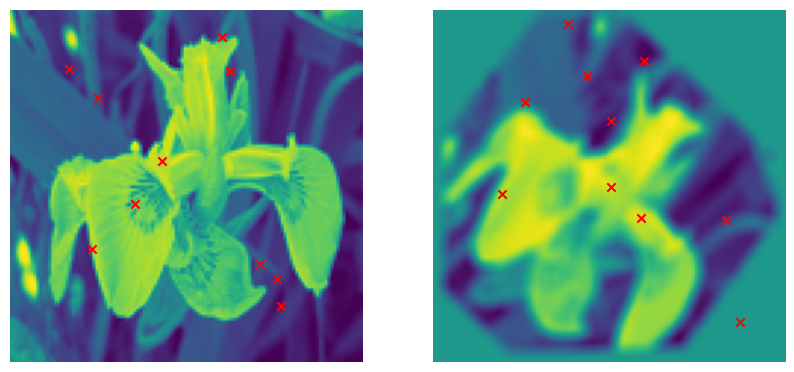

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


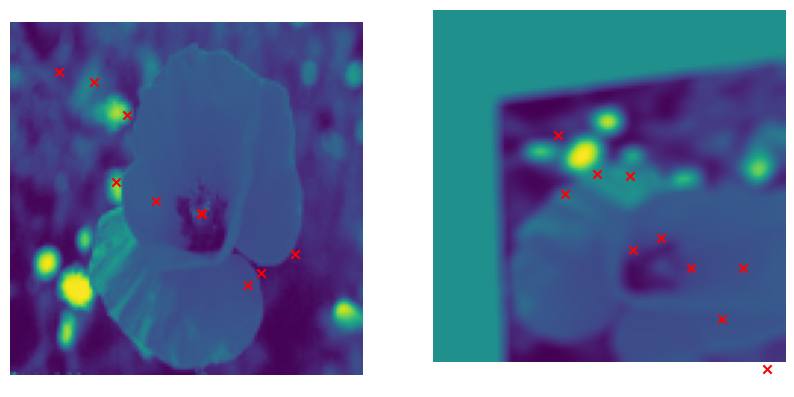

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


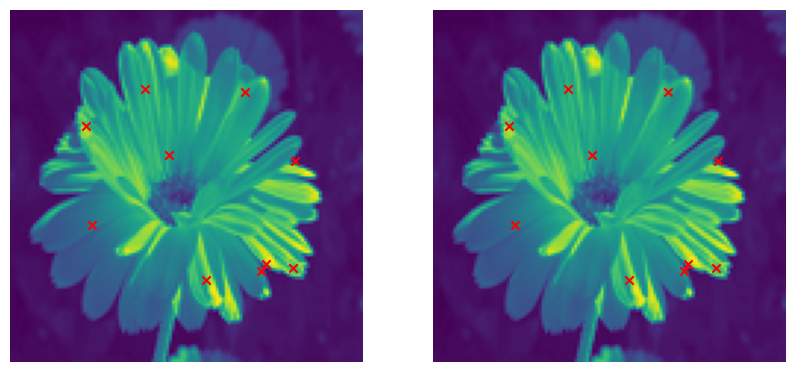

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


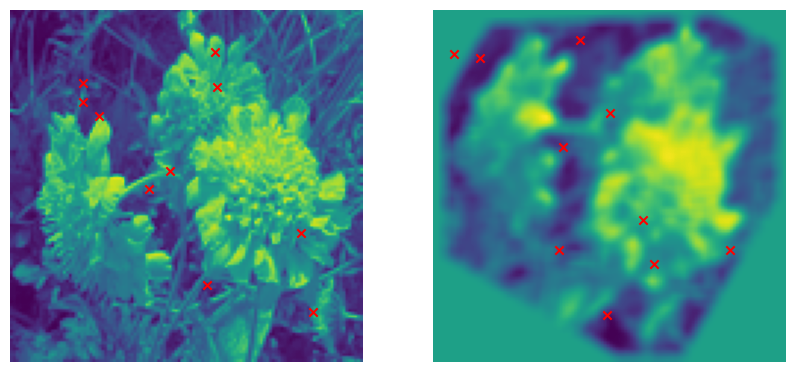

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


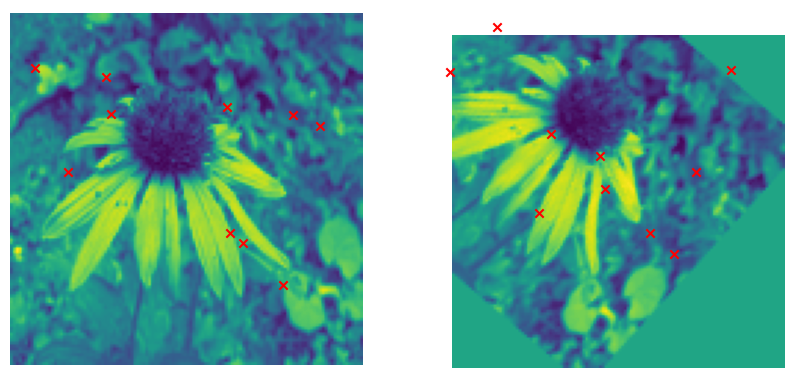

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


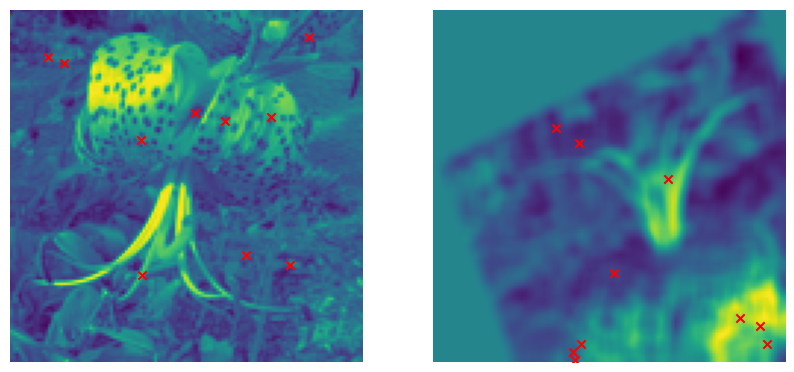

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


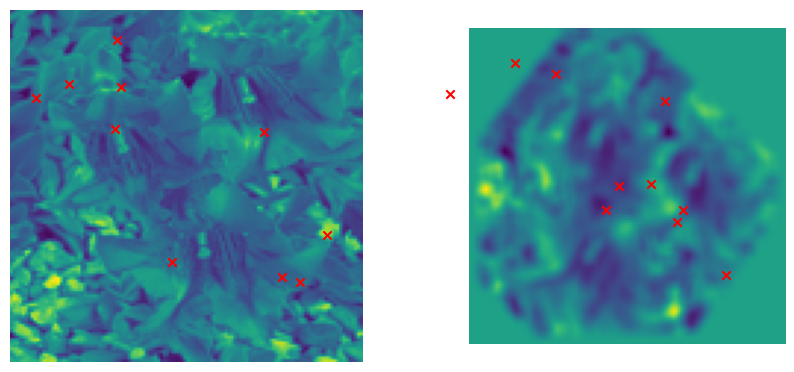

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


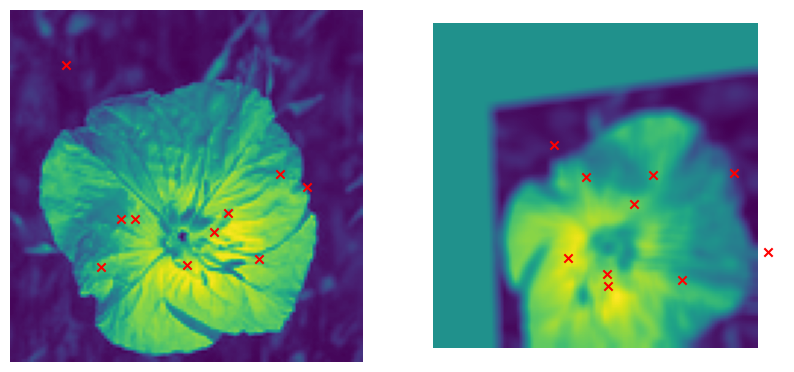

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


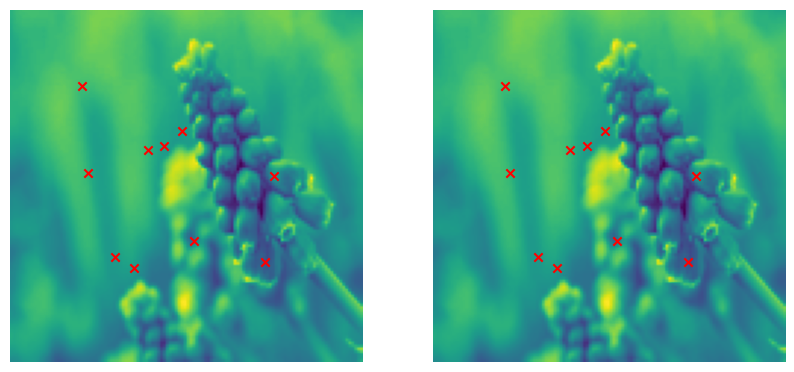

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


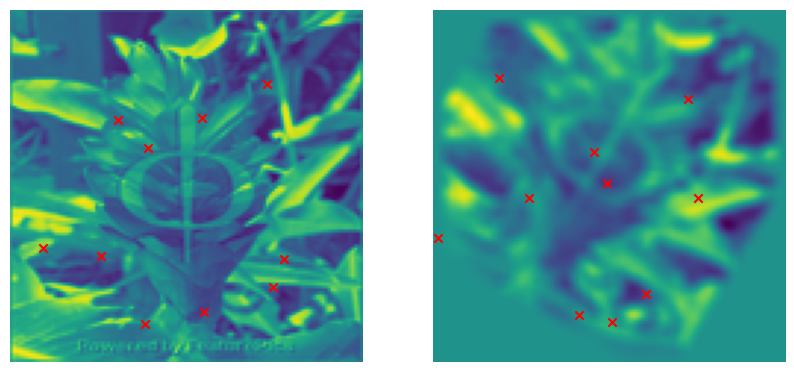

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


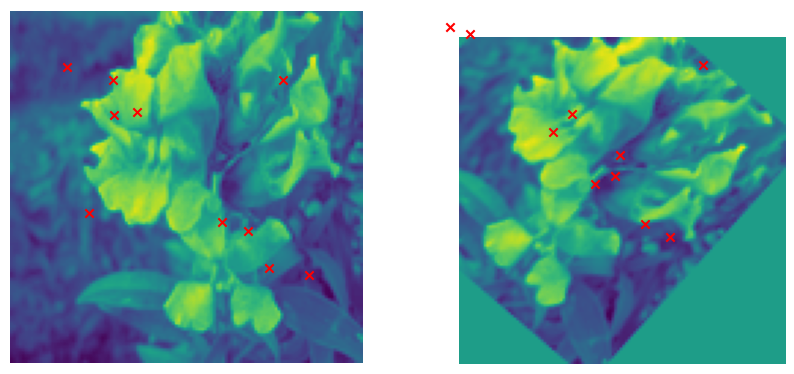

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


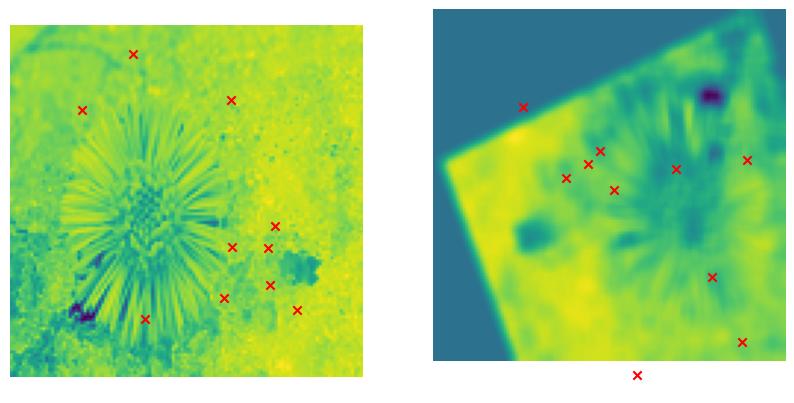

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


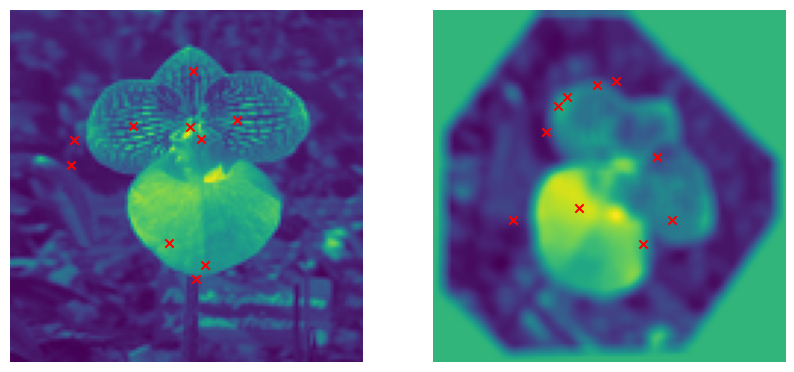

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


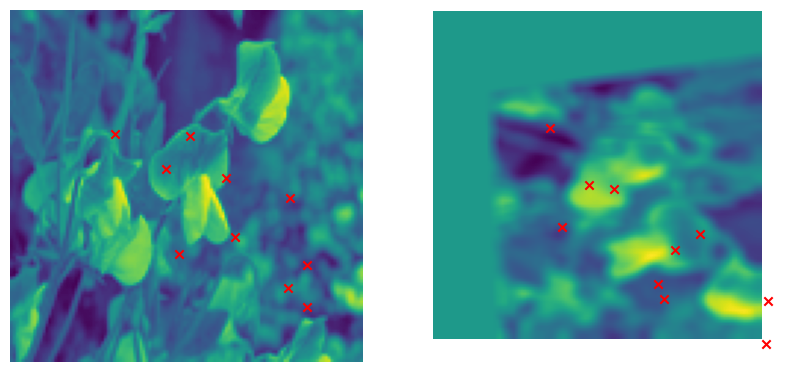

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


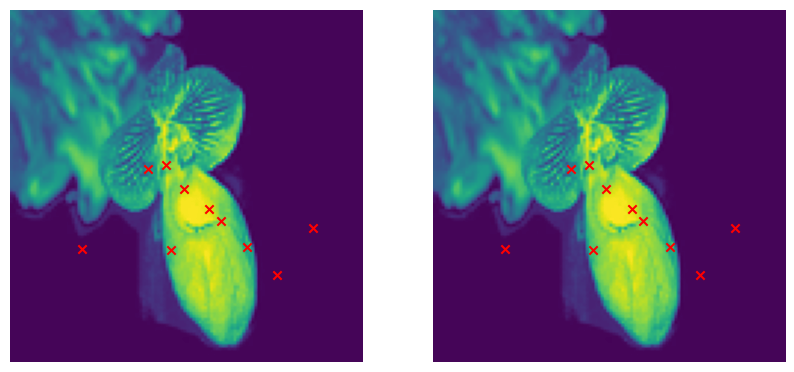

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


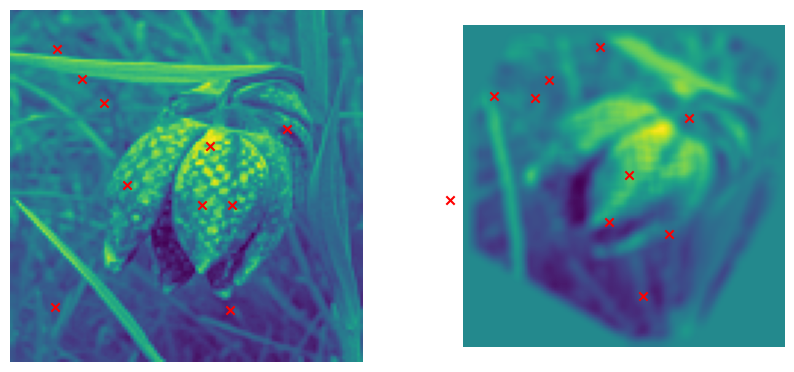

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


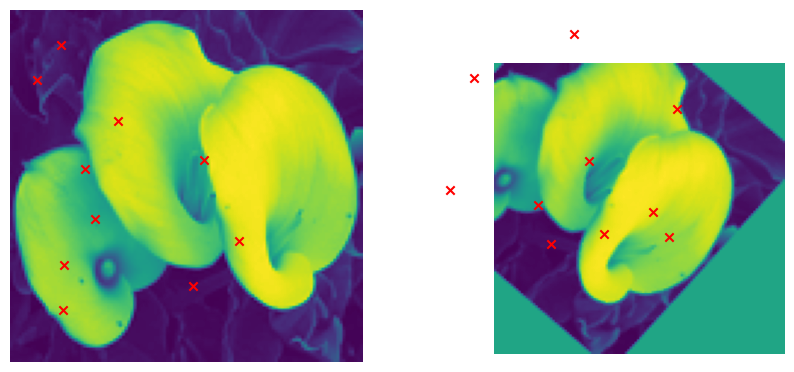

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


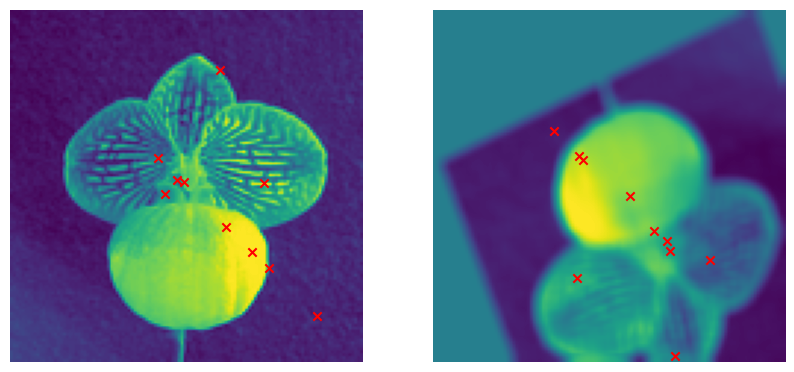

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


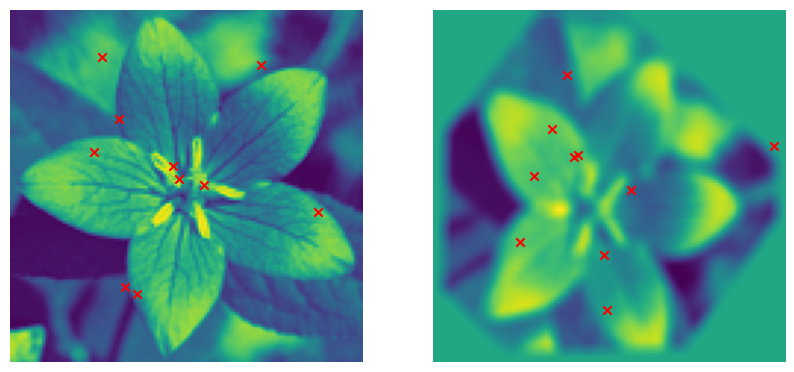

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


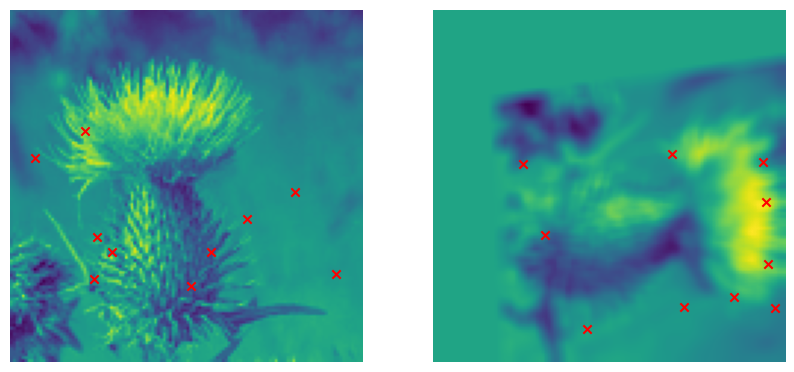

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


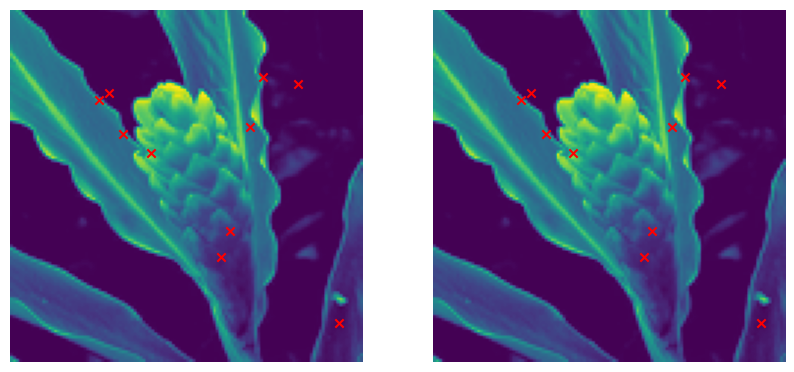

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


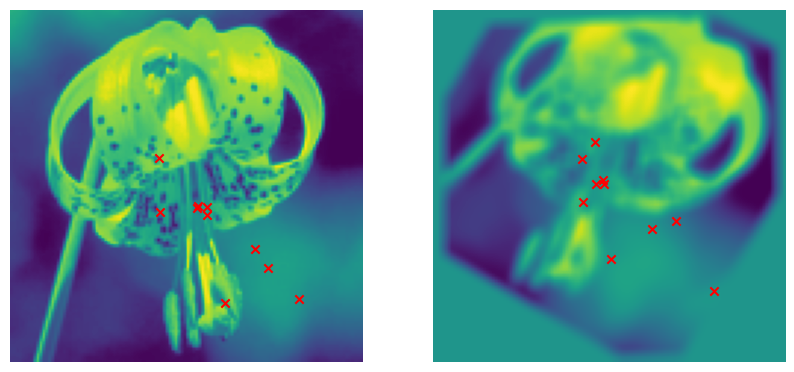

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


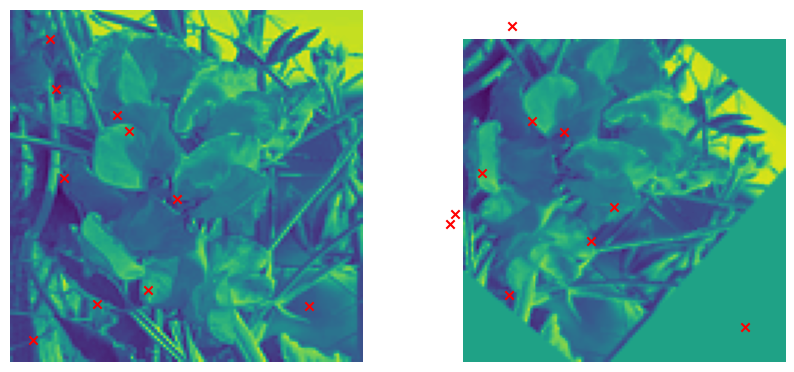

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


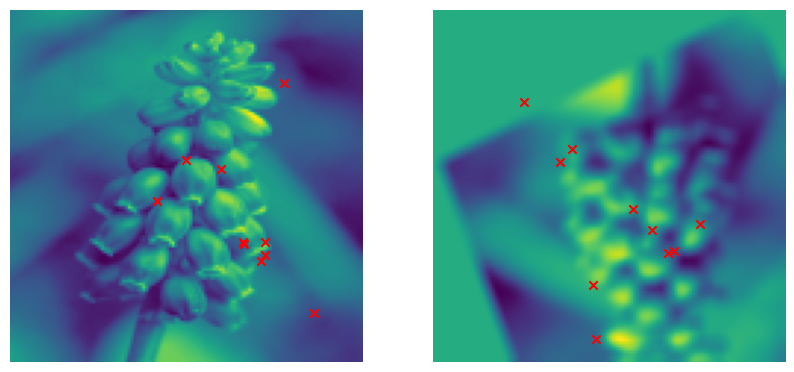

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


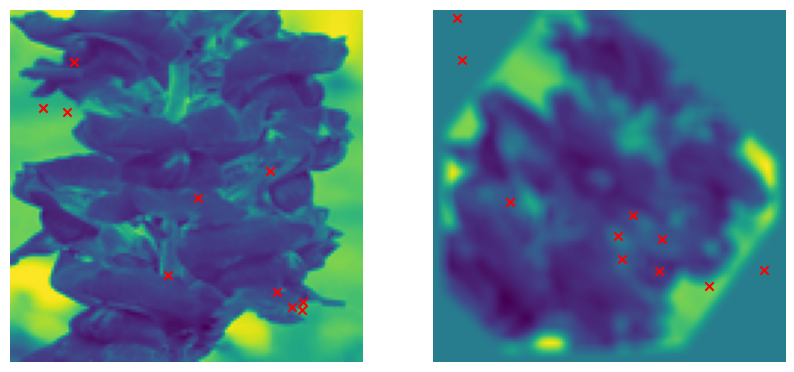

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


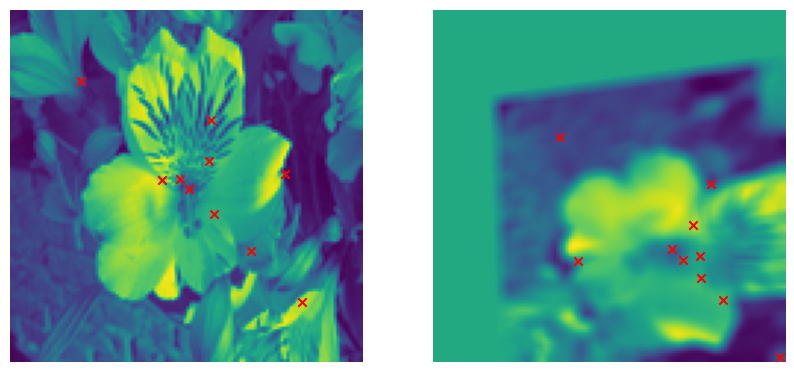

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


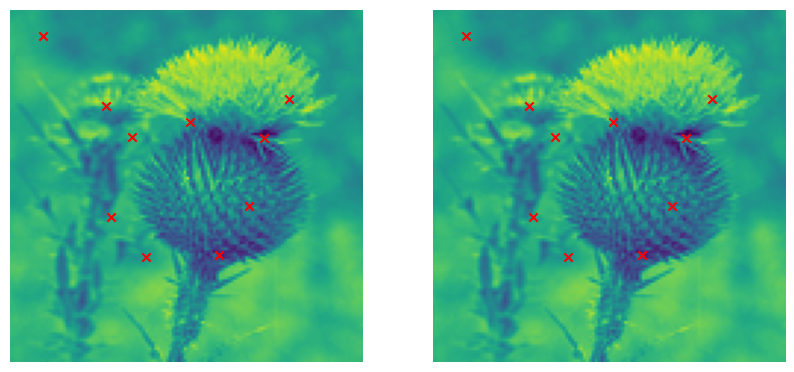

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


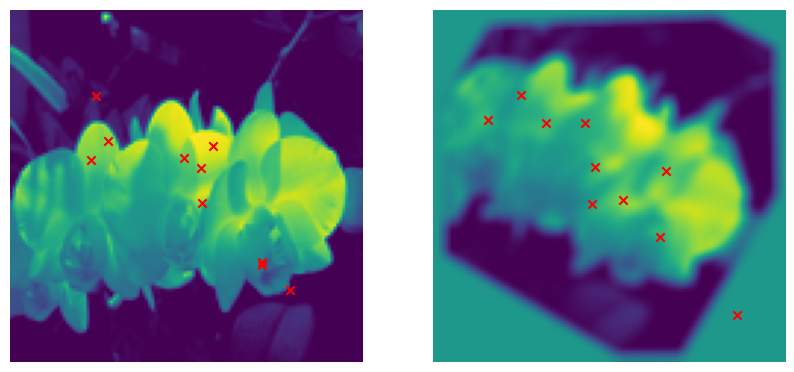

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


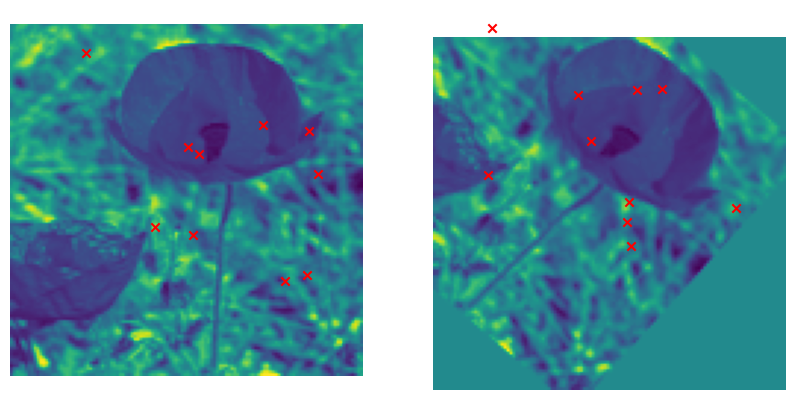

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


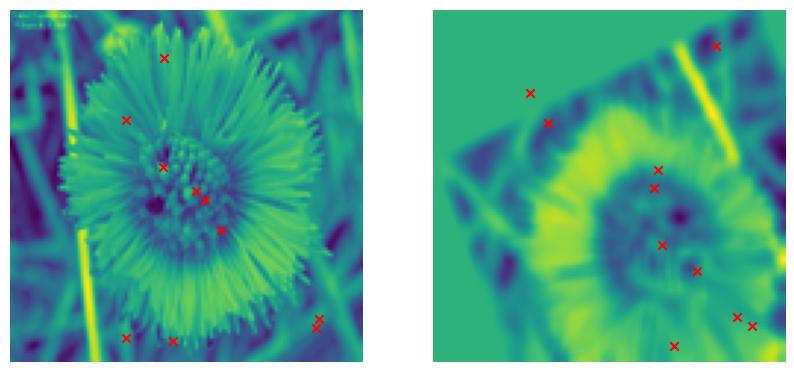

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


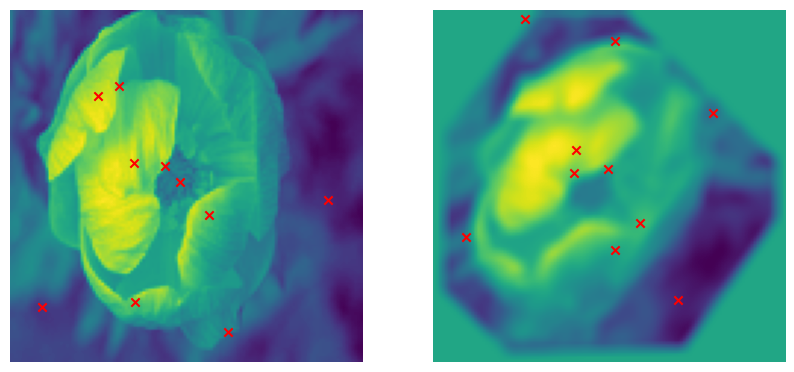

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


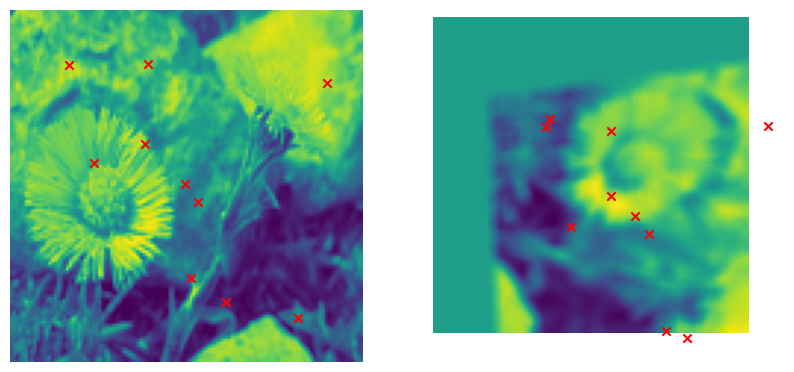

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


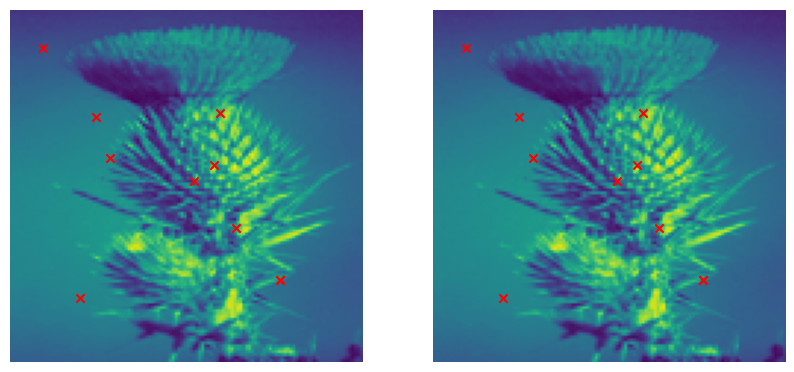

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


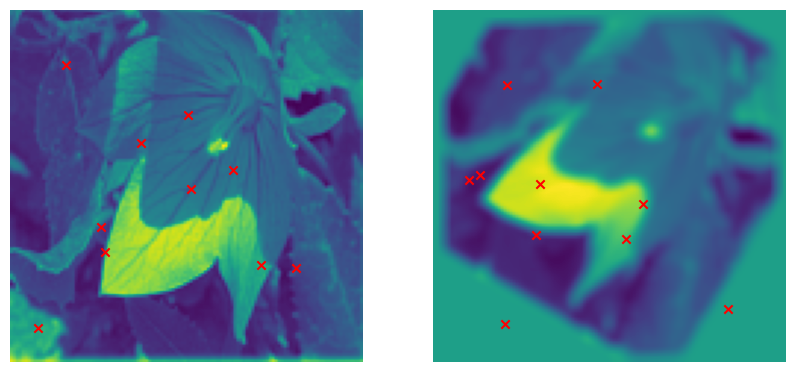

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


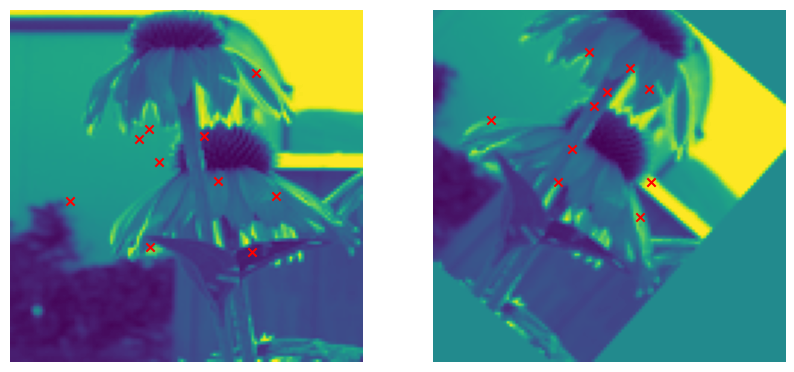

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


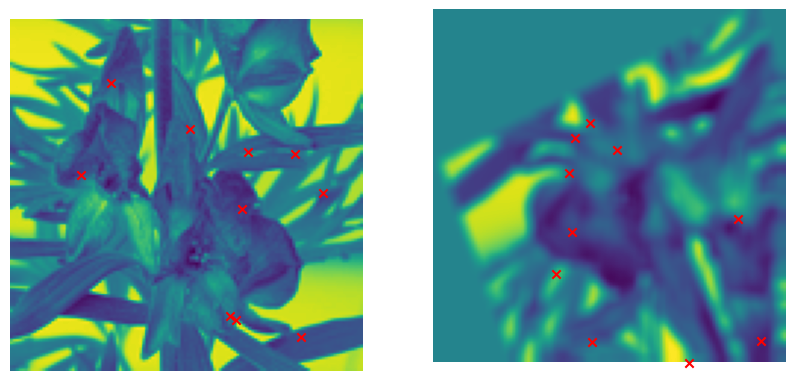

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


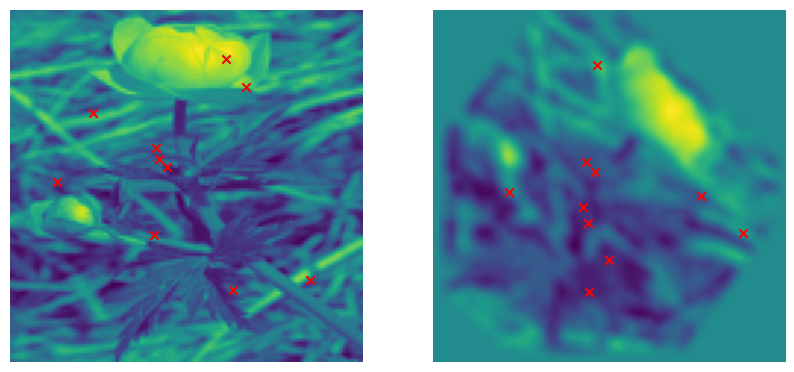

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


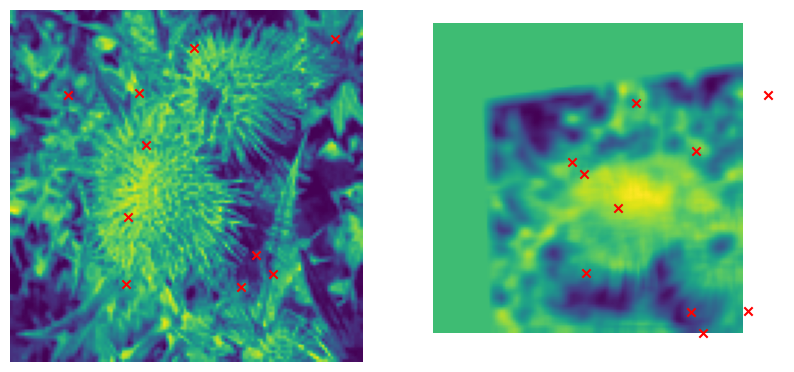

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


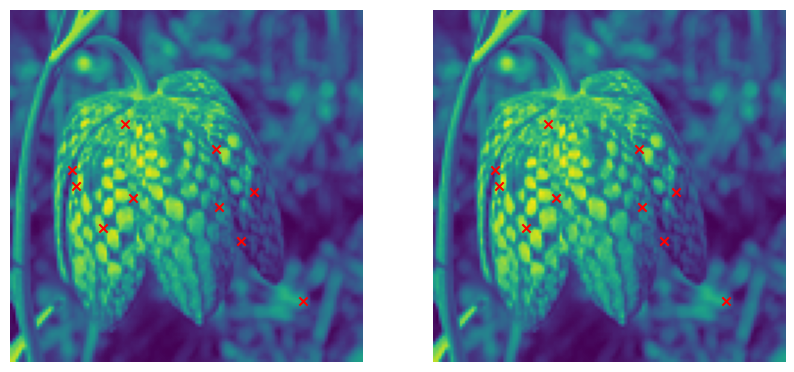

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


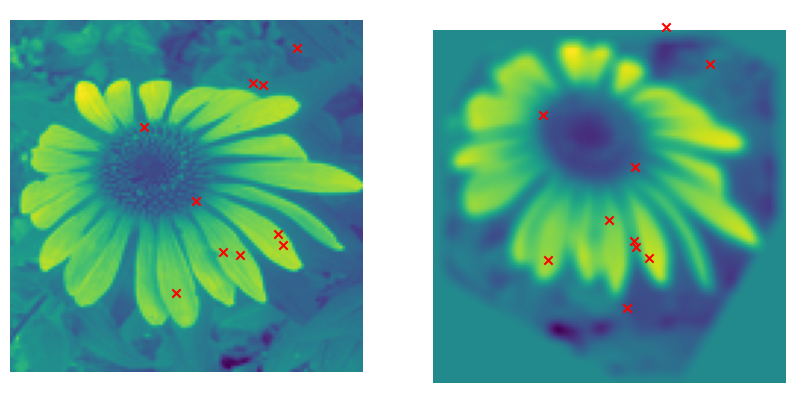

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


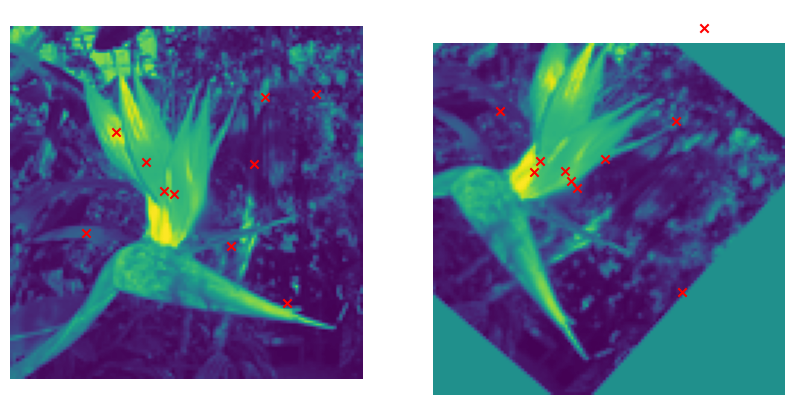

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


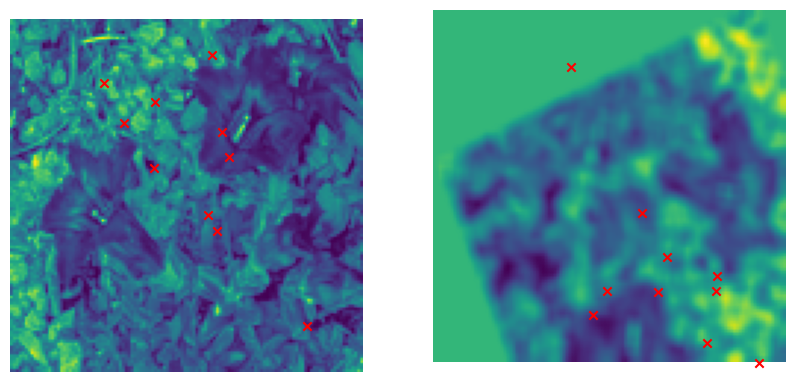

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


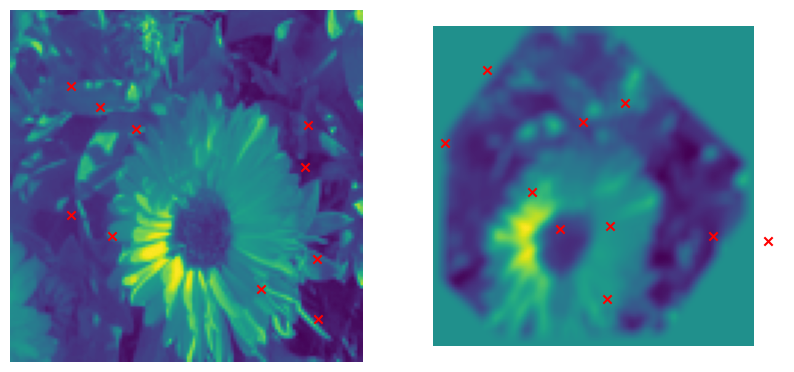

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


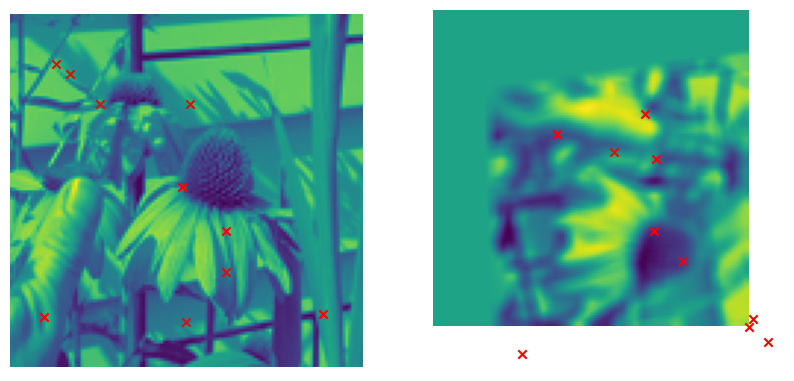

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


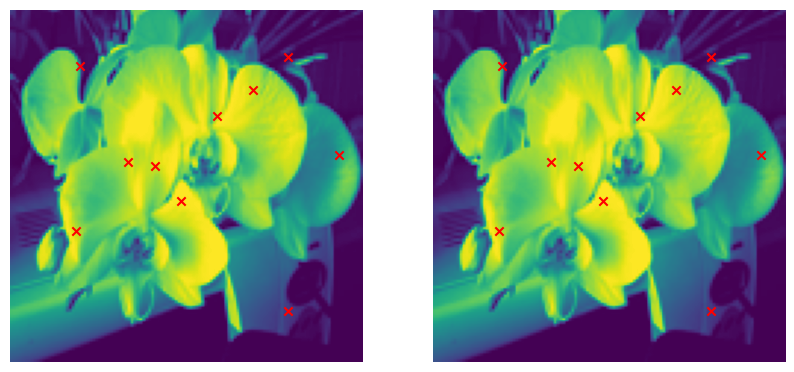

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


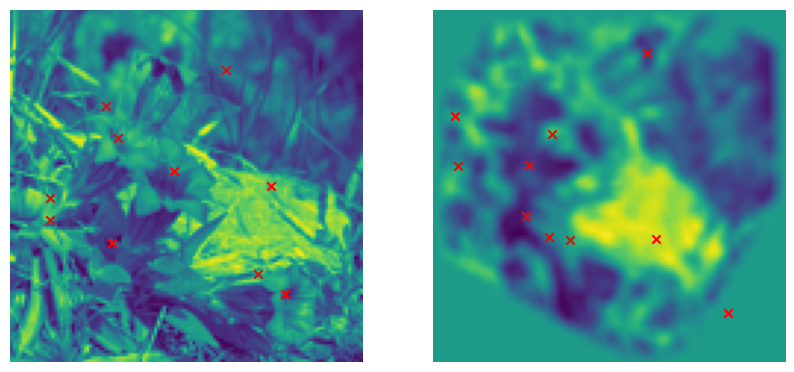

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


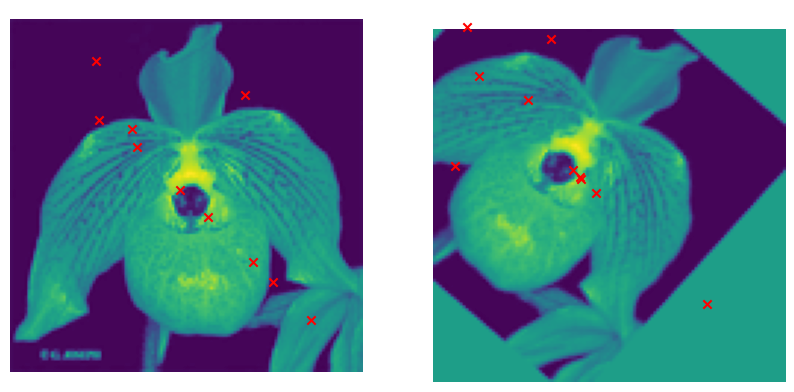

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


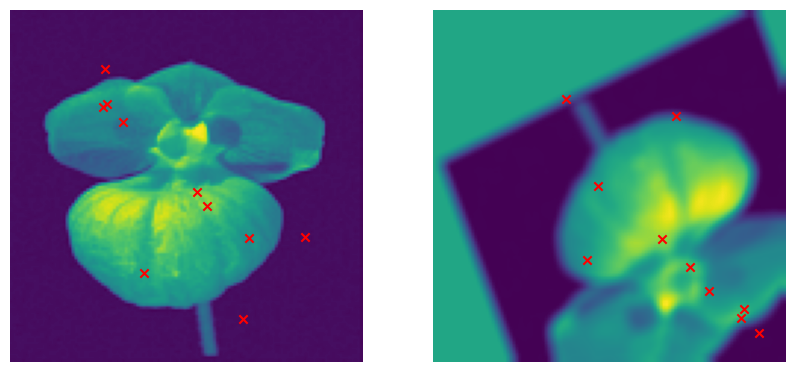

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


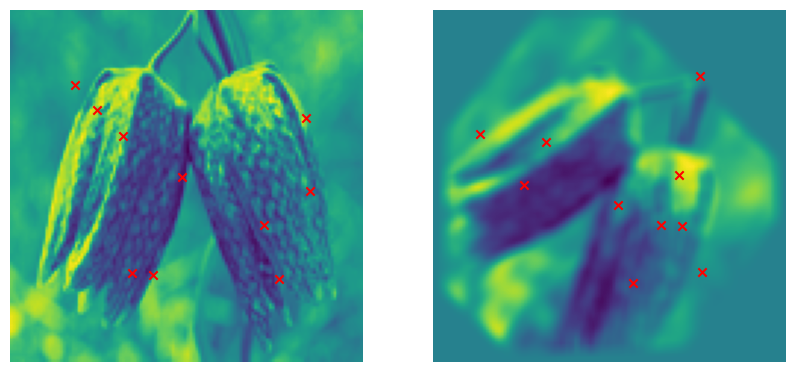

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


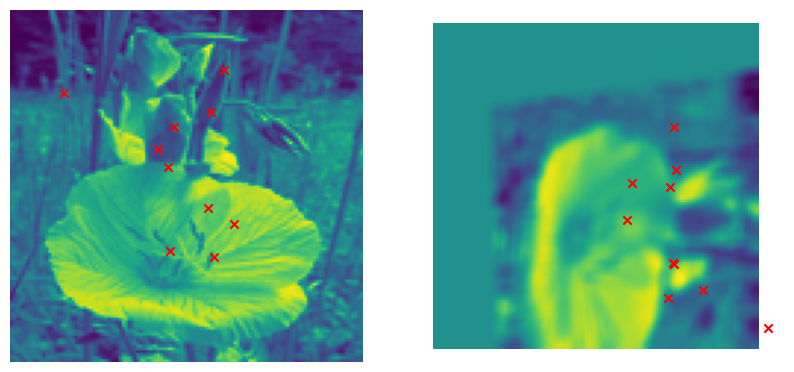

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


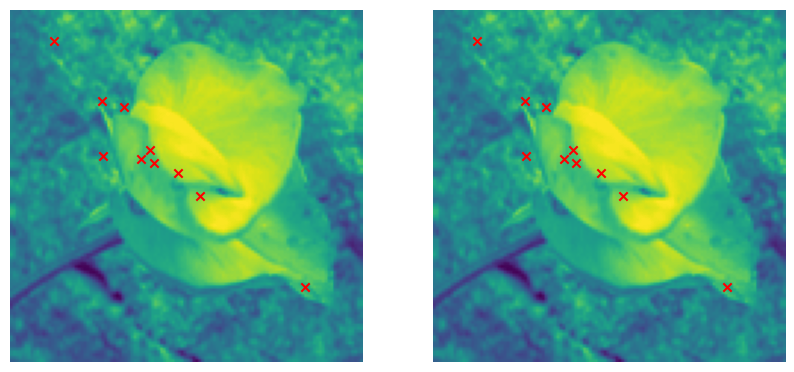

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


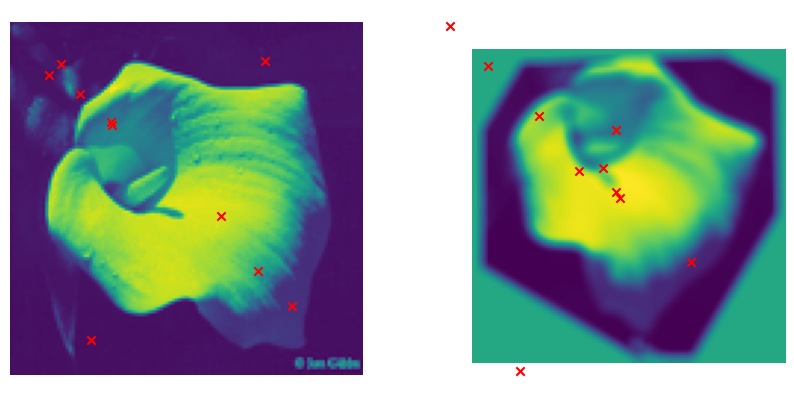

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


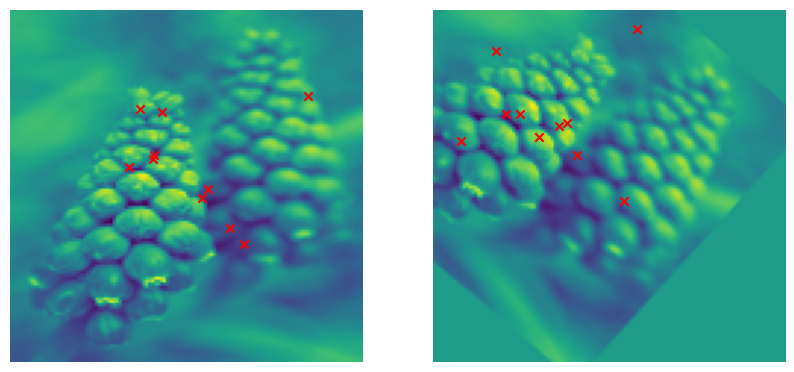

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


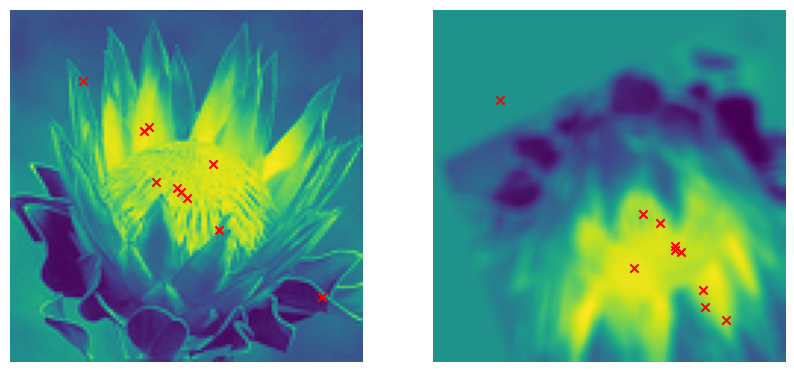

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


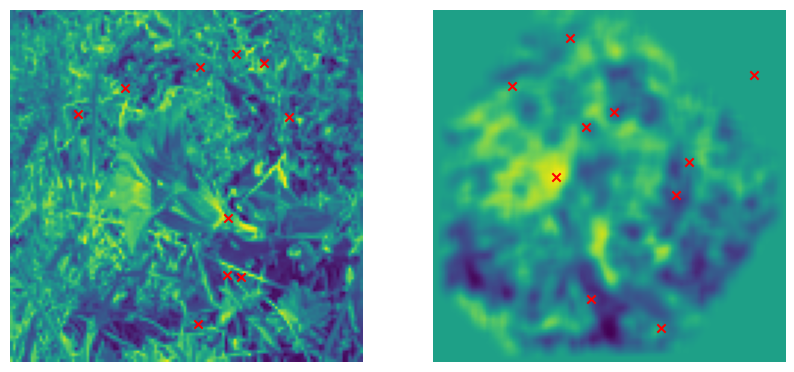

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


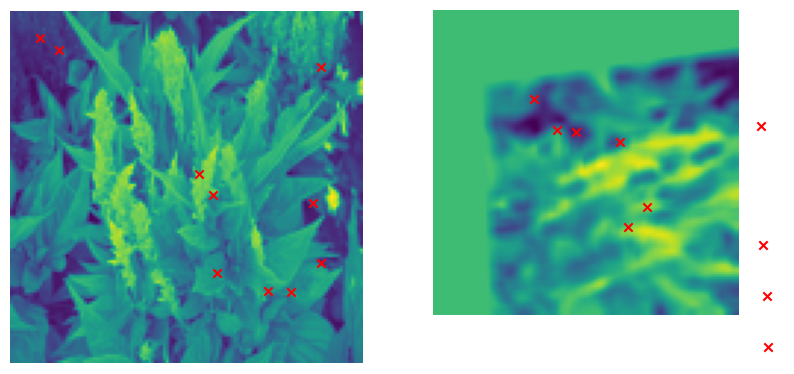

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


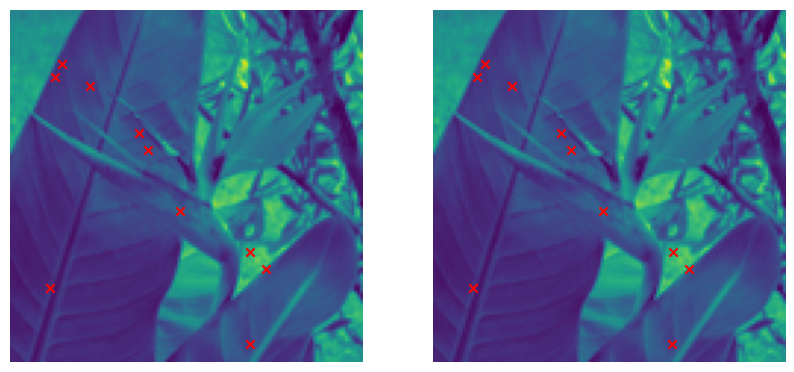

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


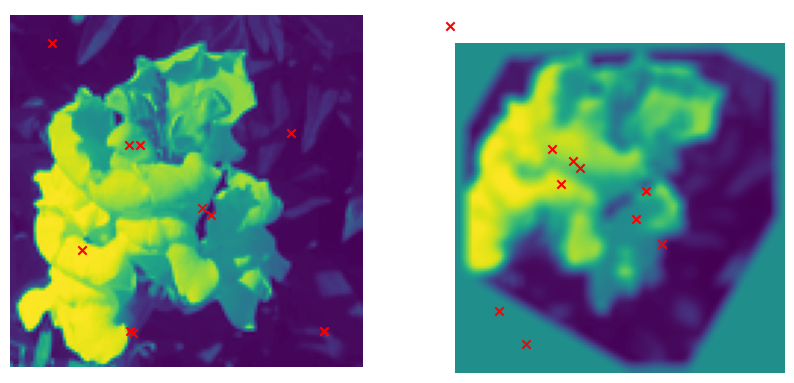

src_pts  torch.Size([5, 10, 2]) torch.Size([5, 10, 2, 3])


KeyboardInterrupt: 

In [7]:

acertos = 0
total = 0
from tqdm.notebook import tqdm
pbar =  tqdm(testloader)
for imgs_batch,labels_batch in pbar:# itera em todo dataset
    imgs_batch = imgs_batch.to(device)
    params_item = next(params_lists)    
    patches1= detect_extract_patches(imgs_batch,params_item,detector,PS)

    
